## IMPORTACIÓ INFORMACIÓ DE SABIO-RK

Per obtenir les dades necessàries per a generar el model utilitzarem la web SABIO-RK d'on ens descarregarem tota la informació per començar a treballar. Per fer-ho cal que ens instal·lem el paquet de python _requests_. 

El paquet _requests_ és una biblioteca utilitzada per realitzar sol·licituts HTTP i interactuar amb recursos web. Proporciona una API simple i intuitiva per enviar sol·licituts HTTP, manipular respostes i gestionar aspectes de comunicació web. 

La instal·lació d'aquest paquet ens permetrà reportar informació específica de la base  dades. Concretament volem generar un document csv on hi guardem els camps SabioReaction ID, Name, Role i Smiles de totes les molècules que formen reaccions químiques. Seguidament importem els ECNumbers de cada reacció, ja que es troben en una altra URL i no ho podem importar tot junt. 

A continuació es crearà un script per tenir un document final amb les següents columnes: SabioReaction ID, Name, Role, Smiles i ECNumber.

In [23]:
#install
import requests
import pandas as pd 

from urllib.request import urlopen
from urllib.parse import quote

def CIRconvert(ids):
    try:
        url = 'http://cactus.nci.nih.gov/chemical/structure/' + quote(ids) + '/smiles'
        ans = urlopen(url).read().decode('utf8')
        return ans
    except:
        return 'Did not work'


import os.path 

datafile = "data/smiles.csv"

if os.path.exists(datafile): 
    print(datafile, " exists") 
else: 
    print("Generating ",datafile)

    QUERY_URL = 'http://sabiork.h-its.org/sabioRestWebServices/searchReactionParticipants'
 
    query = {"SabioReactionID":"*", "fields[]":["Name","Role", "Smiles" ]}

    request = requests.post(QUERY_URL, params = query) 
    request.raise_for_status() 

    print(request.text)

    # results

    fh=open(datafile, "w")

    fh.write(request.text)



data/smiles.csv  exists


A partir de la informació descarregada a la web SABIO-RK hem generat un document csv (smiles.csv) amb la informació de tota la basa de dades, concretament de 16.513 molècules.

In [24]:
smilesfile = "data/smiles.csv"

Ens descarraguem els ECNumbers presents a SABIO-RK:

In [60]:
datafile = "data/ECnumber.csv"

if os.path.exists(datafile):
    print(datafile, "exists")
else:
    print("Generting", datafile)

    QUERY_URL = 'http://sabiork.h-its.org/sabioRestWebServices/searchReactionDetails' 

    query = {"SabioReactionID":"*", "fields[]":["SabioReactionID", "ECNumber"]} 

    # make GET request 
    request = requests.get(QUERY_URL, params = query) 
    request.raise_for_status() 

    #results 
    print(request.text) 

    fh=open("data/ECnumber.csv", "w")

    fh.write(request.text)

    df = pd.read_csv("data/ECnumber.csv", sep='\t')
    df1 = df.sort_values('SabioReactionID')
    print(df1)

data/ECnumber.csv exists


A partir de la informació present a la web ens hem descarregats tots els ECNumbers de les molècules de la base de dades SABIO-RK. Hem generat un document csv (ECnumber.csv) amb 12.165 molècules i els seus ECNumbers. 

Tenint en compte que en el document anterior teniem 16.513 molècules, d'aquestes només podrem utilitzar 12.165 ja que de la resta no tenim informació de l'ECNumber.

Ajuntem els dos documents csv per obtenir el document csv final amb les columnes, SabioReaction ID, Name, Role, Smiles i ECNumber, utilitzant la instrucció "merged".

In [61]:
input1=smilesfile
input2='data/ECNumber.csv'

df1 = pd.read_csv(input1, sep='\t')
df2 = pd.read_csv(input2, sep="\t")

# Merge the two dataframes on the common column "numbers"
merged_df = pd.merge(df1, df2, on="SabioReactionID")

# Write the merged dataframe to a new CSV file
merged_df.to_csv("data/SmilesEC.csv", index=False)

# ReactionSmiles.csv

A partir del document smiles.csv es genera un fitxer amb les reaccions.

In [14]:
input= "data/smiles.csv"
output='data/ReactionSmiles.csv'

df1 = pd.read_csv(input, sep='\t')

#Volem eliminar tota la informació de les reaccions que tinguin algun valor nul en els seus subtrats i productes a la columna smiles.

#Primer afegim 0 on tronem valors NaN a la columna Smiles del dataframe.
df1['Smiles'] = df1['Smiles'].fillna(0)

# generem una llista buida on guardarem el SabioReactionID dels substrats i productes que s'hagin d'elimianr 
list1 = [] 

# iterem el df1   
for i in range(len(df1)): 

    # Si Smiles es igual a 0 afegim el SabioReactionID a la list1 
    if df1.loc[i,'Smiles'] == 0:
        list1.append(df1.loc[i,'SabioReactionID']) 
#Eliminem del df1 tots els substrats i productes que tinguin el SabioReactionID igual que el que s'ha guardat a la llista
df = df1.drop(df1[df1['SabioReactionID'].isin(list1)].index) 

print(df1)

df = df.reset_index()  #la funció rest_index() restableix l'índex del dataframe, estableix una llista del 0 fins a la longitud del dataframe
numrows=16513

df2 = pd.DataFrame(columns=["SabioReactionID", "Reaction"]) #, index=range(numrows))

#Creem dues llistes buides amb tants strings com files. Generem una llista R per guardar els reactius i una llista P per guardar els productes.
R=[""]*(numrows+1)
P=[""]*(numrows+1)
isFirstR=[True]*(numrows+1)
isFirstP=[True]*(numrows+1)

def check_smiles(smiles):
    print(smiles)
    if not smiles:
        print('Wrong SMILES for:',smiles)
        return 0
    return 1

#Fem una iteració per cada fila del dataframe amb el command: for index, row in df.iterrows():
for index, row in df.iterrows():
    rid=row['SabioReactionID']
    name=row["Name"]
    smiles=row["Smiles"]
    if check_smiles(smiles) == 0:
        break
   
    role=row["Role"]
    if role == "Substrate": 
        if isFirstR[rid]:
            R[rid]=R[rid] + smiles 
            isFirstR[rid]= False
        else:
            R[rid]=R[rid] + "." + smiles       
        
    elif role == "Product":
        if isFirstP[rid]:
            P[rid]=P[rid]+smiles
            isFirstP[rid]=False
        else:
            P[rid]=P[rid] +"."+ smiles
    else:
        print("error, name")
    print(R[rid],P[rid])
    df2.at[rid, "SabioReactionID"]=rid

for i in range(numrows):
    print(R[i]+">"+P[i])
    df2.at[i, "Reaction"]=R[i]+">>"+P[i]

  

df2.drop(df2.tail(11478).index,inplace=True)
print(df2)

#obtenim ReactionSmiles.csv.
df2.to_csv(output)

       SabioReactionID                              Name       Role  \
0                    1       alpha-D-Glucose 6-phosphate  Substrate   
1                    1       beta-D-Fructose 6-phosphate    Product   
2                    2                               ATP  Substrate   
3                    2  beta-D-Fructose 1,6-bisphosphate    Product   
4                    2                               ADP    Product   
...                ...                               ...        ...   
62291            16513                                H+    Product   
62292            16513                                O2  Substrate   
62293            16513                                CO    Product   
62294            16513      2-Heptyl-3-hydroxy-quinolone  Substrate   
62295            16513        n-Octanoylanthranilic acid    Product   

                                                  Smiles  
0      C([C@@H]1[C@H]([C@@H]([C@H]([C@H](O1)O)O)O)O)O...  
1      C([C@@H]1[C@H]([C@@H](

S'afageix els ECNumber de cada reacció i s'eliminen aquelles reaccions que no tenen ECNumber.

In [63]:
input1="data/ReactionSmiles.csv"
input2='data/ECnumber.csv'

df1 = pd.read_csv(input1, sep=',')
df2 = pd.read_csv(input2, sep="\t")

# A partir de la funció Merge ajuntem els dos dataframes tenint en compte la columna del SabioReactionID. D'aquesta manera aconseguim un dataframe amb la columna ReactionSmiles i la columna ECNumber.
merged_df = pd.merge(df1, df2, on="SabioReactionID")

#Eliminar aquelles reaccions que no disposin d'ECNumber.
merged_df = merged_df.drop(merged_df[merged_df['ECNumber'] == "-"].index)

# Escrivim el dataframe final a un nou CSV file. 
merged_df.to_csv("data/ReactionSmilesEC.csv", index=False)

Per poder traball amb RDKit i obtenir les _features_ de cada substància necessitem un csv amb els SMILES de cada substrat i producte per separat. L'objectiu del seggüent script és obtenir un llistat de tots els substrats i productes de totes les reaccions químiques del nostre dataset sense tenir molècules per duplicat. 

In [64]:
# En el següent script treballarem a partir del csv obtingut de SABIO-RK:
input= smilesfile
output='data/moleculesSmiles.csv'

df1 = pd.read_csv(input, sep='\t')

#Eliminem totes les molècules que no tinguin SMILES.
df1['Smiles'] = df1['Smiles'].fillna(0)
# creem uns llista buida.  
list1 = [] 
#smiles=row["Smiles"]   
for i in range(len(df1)): 

    # comprovem si Smiles és igual a 0, llavors afegim el valors SabioReactionID a la llista list1 
    if df1.loc[i,'Smiles'] == 0: 
        list1.append(df1.loc[i,'SabioReactionID']) 

df = df1.drop(df1[df1['SabioReactionID'].isin(list1)].index) 

#Una vegada hem eliminat les molècules que no tenen SMILES eliminem aquelles molècules duplicades al dataframe.
dfmolecules = df.drop_duplicates(subset="Smiles")

#Guardem el dataframe en un csv file moleculesSmiles.csv
print(dfmolecules)
dfmolecules.to_csv(output)

       SabioReactionID                                   Name       Role  \
0                    1            alpha-D-Glucose 6-phosphate  Substrate   
1                    1            beta-D-Fructose 6-phosphate    Product   
2                    2                                    ATP  Substrate   
3                    2       beta-D-Fructose 1,6-bisphosphate    Product   
4                    2                                    ADP    Product   
...                ...                                    ...        ...   
62233            16502                        10-Formylfolate  Substrate   
62256            16507  15-Keto-prostaglandin E2 methyl ester    Product   
62257            16507          Prostaglandin E2 methyl ester  Substrate   
62294            16513           2-Heptyl-3-hydroxy-quinolone  Substrate   
62295            16513             n-Octanoylanthranilic acid    Product   

                                                  Smiles  
0      C([C@@H]1[C@H]([C@@H]

# RDKit
 És una llibreria de codi obert de química computacional de python. Està dissenyat per a la manipulació de molècules i estructures químiques. RDKit té moltes funcions algunes d'elles són la conversió entre diferents formats de fitxers de molècules, la generació d'estructures moleculars, el càlcul de propietats físico-químiques de les molècules, com ara la solubilitat, el pes molecular, el nombre d'àtoms rotatius, la càrrega, etc. També permet generar visualitzacions 2D i 3D de molècules. Nosaltres l'utilizarem per a obtenir les _features_ , propietats fisico-químiques, que ens serviran de _finguerprints_ per a la generació del model ML. 

 Descriptors RDKit:

- Pes molecular: El pes molecular d'una molècula pot estar relacionat amb la seva activitat enzimàtica, ja que les molècules més grans o més complexes poden tenir més probabilitats d'interaccionar amb enzims específics. 

- Lipofílicitat: Capacitat d'un compost a dissoldre's en lípids o dissolvents no polars.

- Àrea de superfície polar topològica (TPSA) Chem.Descriptors.TPSA(): és una mesura de l'àrea superficial d'una molècula que és polar o capaç de participar en l'enllaç d'hidrogen. La TPSA pot estar relacionada amb l'activitat enzimàtica, ja que molts enzims tenen llocs actius polars o carregats. 

- Nombre d'heteroàtoms. NumHeteroatoms()

- Nombre d'anells. RingCount()

- Nombre d'anells aromàtis. NumAromaticRings()

- Nombre d'àtoms pesants: Chem.Descriptors.HeavyAtomCount(mol)

- Nombre d'anells alifàtics: Chem.Descriptors.NumAliphaticRings(mol)

- Fraction of carbons that are sp3 hybridized: Chem.Descriptors.FractionCSP3(mol)

- Number of chiral centers: Chem.Descriptors.NumChiralCenters(mol)

- Balaban J index: Chem.Descriptors.BalabanJ(mol) : L'índex J de Balaban mesura el grau d'insaturació d'una molècula. Està relacionat amb la reactivitat química i l'estabilitat d'una molècula, així com amb la seva aromaticitat. Les molècules amb índex més alts tendeixen a tenir graus més alts d'insaturació i, per tant, són més reactives mentre que les molècules amb índex més baixos solen ser més estables.

- Number of rotatable bonds: Chem.Descriptors.NumRotatableBonds(mol)

In [65]:
import pandas as pd
from rdkit import Chem
from rdkit.Chem import Crippen, Descriptors
import matplotlib.pyplot as plt

df1 = pd.read_csv('data/moleculesSmiles.csv', sep=',')
df1['mol'] = df1['Smiles'].apply(lambda x: Chem.MolFromSmiles(x))
print(type(df1['mol'][0]))

output = 'data/fingerprint.csv'

mols = df1['mol']

def smiles_to_mol(smiles):
    mol = Chem.MolFromSmiles(smiles)
    return mol


def features(mol, data):
    # Extraiem les propietats utilitzant funcions de RDKit
    if mol is None:
        # If the molecule creation failed, handle the error
        print('Error: Unable to create the molecule from the SMILES string.')
    else:
        #Fem modificacions a les molècules per resoldre els errors.
        Chem.Kekulize(mol)#fixem els atoms unkekulized.
        Chem.Kekulize(mol)#corregim els problemes de valència o connectivitat.
        
        #Generem SMILES vàlids de les molècules.
        smiles = Chem.MolToSmiles(mol)

        #Obtenim les característiques de cada molècula. 
        formula = Chem.rdMolDescriptors.CalcMolFormula(mol)
        mw = Chem.rdMolDescriptors.CalcExactMolWt(mol)  # pes molecular
        logp = Chem.Descriptors.MolLogP(mol)
        tpsa = Chem.rdMolDescriptors.CalcTPSA(mol)
        num_rc = Chem.Descriptors.RingCount(mol)
        num_AR = Chem.Descriptors.NumAromaticRings(mol)
        num_HAC = Chem.Descriptors.HeavyAtomCount(mol)
        num_AR = Chem.Descriptors.NumAliphaticRings(mol)
        CSP3 = Chem.Descriptors.FractionCSP3(mol)
        BJI = Chem.Descriptors.BalabanJ(mol)
        num_RB = Chem.Descriptors.NumRotatableBonds(mol)
        num_hbd = Chem.rdMolDescriptors.CalcNumHBD(mol)
        num_hba = Chem.rdMolDescriptors.CalcNumHBA(mol)

        # Afegim els resultats en un llistat de dades.
        data.append([mw, logp, tpsa, num_rc, num_AR, num_HAC, num_AR, CSP3, BJI, num_RB, num_hbd, num_hba])
    return

data = []

for mol in mols:
    features(mol, data)

llistadescriptors = ['MW', 'logP', "TPSA", "Rings Count", "Aromatic Rings", "Heavy atoms count", "Aliphatic Rings",
                     "CSP3", "BalabanJ", "Rotatable Bonds", "H-bond donor", "H-bond acceptor"]

df = pd.DataFrame(data, columns=llistadescriptors)
df["Smiles"] = df1["Smiles"]

print(df)

df.to_csv(output)




[18:19:34] WARNING: not removing hydrogen atom without neighbors
[18:19:34] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[18:19:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9
[18:19:34] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
[18:19:34] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
[18:19:34] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
[18:19:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9
[18:19:34] Can't kekulize mol.  Unkekulized atoms: 7 9 22
[18:19:34] Can't kekulize mol.  Unkekulized atoms: 34 35 39 41 42
[18:19:34] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 9 10 11
[18:19:34] Can't kekulize mol.  Unkekulized atoms: 36 37 38 39 40 41 42 43 44
[18:19:34] Can't kekulize mol.  Unkekulized atoms: 39 40 41 42 43
[18:19:34] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7
[18:19:34] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 11
[18:19:34] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10 11 12
[18:19:34] Can't k

<class 'rdkit.Chem.rdchem.Mol'>
Error: Unable to create the molecule from the SMILES string.
Error: Unable to create the molecule from the SMILES string.
Error: Unable to create the molecule from the SMILES string.
Error: Unable to create the molecule from the SMILES string.
Error: Unable to create the molecule from the SMILES string.
Error: Unable to create the molecule from the SMILES string.
Error: Unable to create the molecule from the SMILES string.
Error: Unable to create the molecule from the SMILES string.
Error: Unable to create the molecule from the SMILES string.
Error: Unable to create the molecule from the SMILES string.
Error: Unable to create the molecule from the SMILES string.
Error: Unable to create the molecule from the SMILES string.
Error: Unable to create the molecule from the SMILES string.
Error: Unable to create the molecule from the SMILES string.
Error: Unable to create the molecule from the SMILES string.
Error: Unable to create the molecule from the SMILES 

Fem un estudi histogràfic dels diferents descriptors (en aquest cas com que estem treballant amb el document de prova i tenim poques molècules els gràfics no són representatius.):

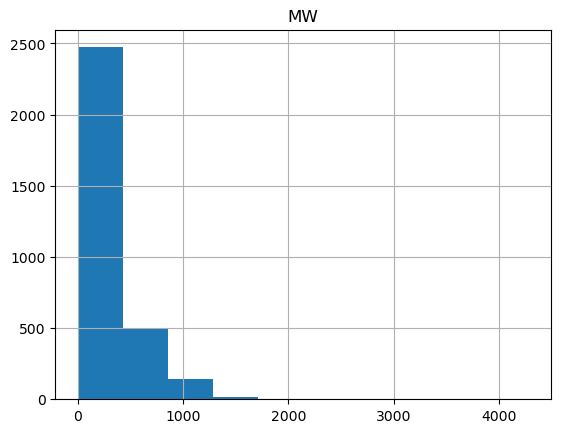

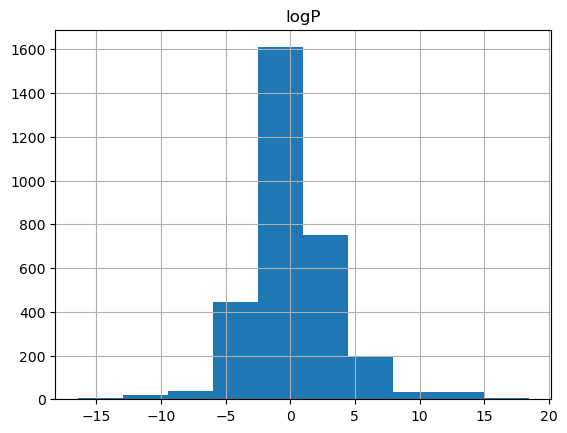

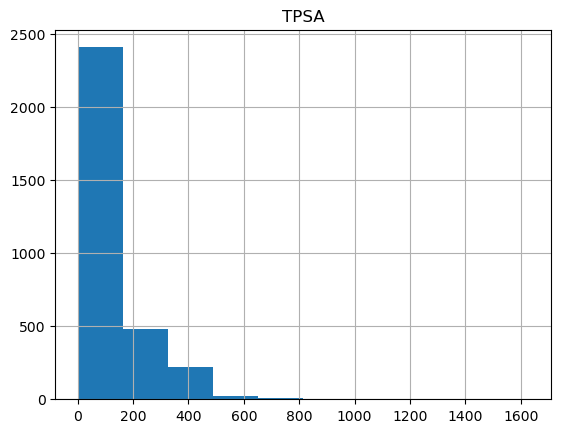

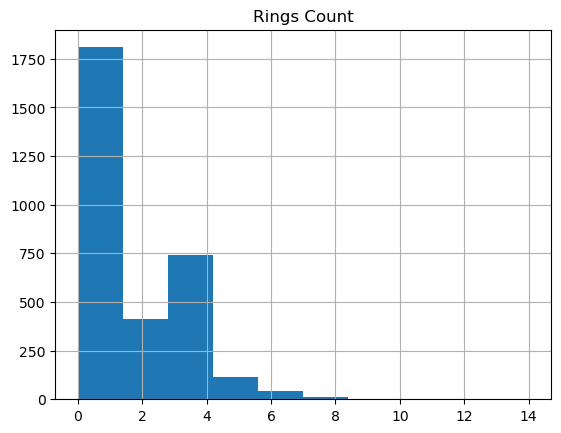

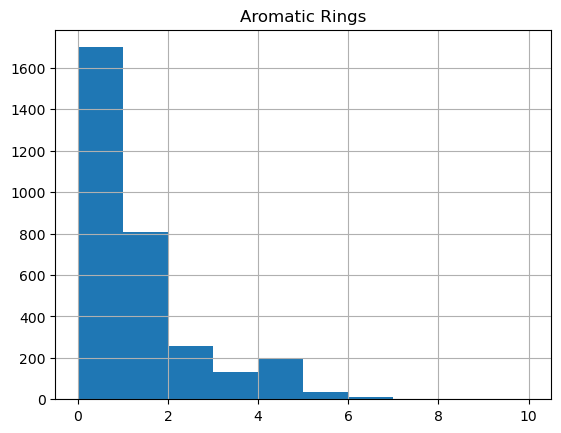

...

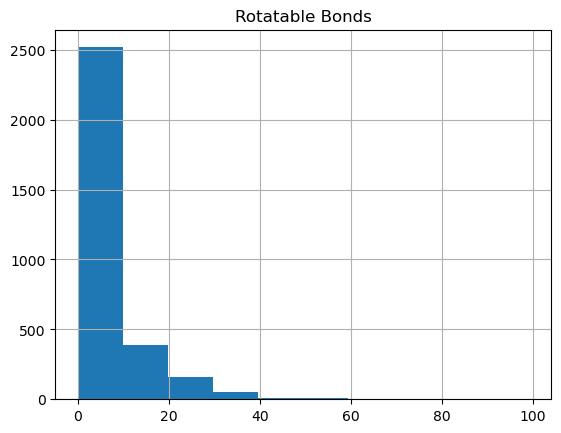

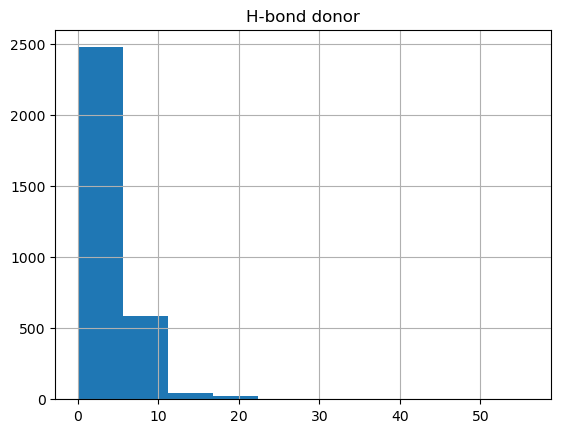

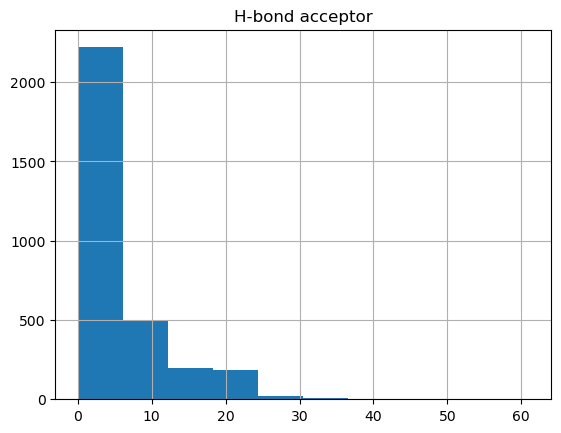

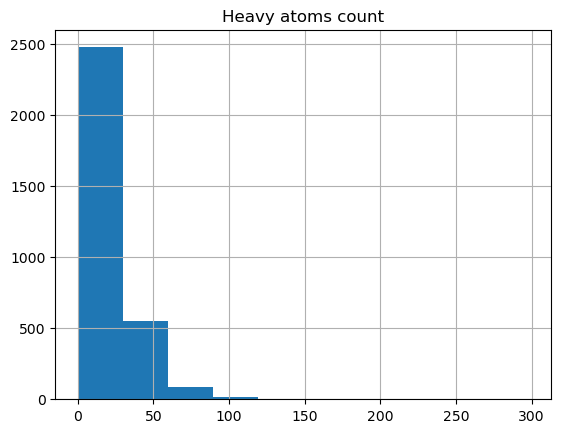

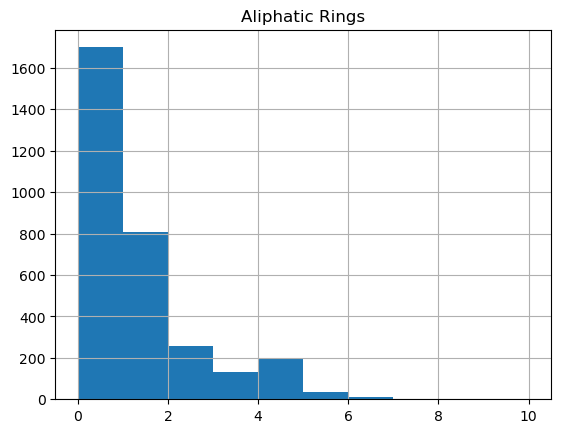

In [44]:
hist1=df.hist(column='MW')
hist2=df.hist(column='logP')
hist3=df.hist(column='TPSA')
hist4=df.hist(column='Rings Count')
hist5=df.hist(column='Aromatic Rings')
hist6=df.hist(column='CSP3')
hist7=df.hist(column='BalabanJ')
hist8=df.hist(column="Rotatable Bonds")
hist9=df.hist(column='H-bond donor')
hist10=df.hist(column='H-bond acceptor')
hist11=df.hist(column="Heavy atoms count")
hist12=df.hist(column="Aliphatic Rings")



Generem un fitxer csv per introduir al programa Chemprop. El fitxer ha de tenir la columna: ReactionSmiles Sabio ID i la suma de fingerprints dels seus substrats i productes. L'objectiu del següent script consisteix en ajuntar el csv que conté els SMILES de les reaccions amb el csv que conté els finguerprints de cada substrat i producte que formen la reacció.

In [17]:
import pandas as pd 

input2 = 'data/fingerprint.csv'
input1 = 'data/ReactionSmiles.csv'
output= 'data/output_file.csv'

df2 = pd.read_csv(input2, sep=',')
df1 = pd.read_csv(input1, sep=',')
#print(df1.columns)

#generem un diccionari que assigni les cadenes SMILES als valors dels descriptors
molecule_descriptors = df2.set_index('Smiles').to_dict('index')


# Funció per afegir descriptors a les reaccions.
def add_descriptors(row):
    reaction_smiles = row['Reaction']
    reactants, products = reaction_smiles.split('>>')
    reactant_smiles = reactants.split('.')
    product_smiles = products.split('.')
    llistadescriptors=['MW','logP',"TPSA", "Rings Count", "Aromatic Rings", "Heavy atoms cout", "Alifatic Rings", "CSP3", "BalabanJ", "RotatableBonds", "H-bond donor", "H-bond acceptor"]
    llistadescriptorsR=[]
    llistadescriptorsP=[]
    for i in llistadescriptors:
        llistadescriptorsR.append("r"+(i))
        llistadescriptorsP.append("p"+(i))
        
    reactrow=pd.Series([0]*12,index=llistadescriptorsR)
    productrow=pd.Series([0]*12,index=llistadescriptorsP)
    
    #print(productrow)

    #print(reactrow)    
    # Recorre cada reactiu i producte i s'afegeixen els descriptors si aquests es troben al diccionari de descriptors de molècules
    for reactant in reactant_smiles:
        try:
            print("reactant:,",reactant)
            ser2=pd.Series(molecule_descriptors[reactant]).drop(labels=['Unnamed: 0']) #eliminem la columna Unnamed i fem la sumna  dels valors de cada variable dels reactius.
             #print('pd.Series\n',ser2)
            reactrow=reactrow.add(ser2)
        except KeyError:
            print(f"No descriptors found for reactant: {reactant}")

    #print(reactrow)
    for product in product_smiles:
        try:
            print("product:",product)
            ser2=pd.Series(molecule_descriptors[product]).drop(labels=['Unnamed: 0']) #eliminem la columna Unnamed i fem la suma dels valors de cada variable dels productes.
            productrow=productrow.add(ser2)
        except KeyError:
            print(f"No descriptors found for product: {product}")
    
    row = pd.concat([row, reactrow, productrow])#, ignore_index=True)
    print(row)
    return row


# Apliquem la funció add_descriptors a cada fila del dataframe de reaccions.
reactions_df = df1.apply(add_descriptors, axis=1)

#print(reactions_df)

# escrivim el dataframe en un csc
reactions_df.to_csv('data/reactions_with_descriptors.csv', index=False)

reactant:, C([C@@H]1[C@H]([C@@H]([C@H]([C@H](O1)O)O)O)O)OP(=O)(O)O
product: C([C@@H]1[C@H]([C@@H]([C@](O1)(CO)O)O)O)OP(=O)(O)O
Unnamed: 0                                                           1
SabioReactionID                                                      1
Reaction             C([C@@H]1[C@H]([C@@H]([C@H]([C@H](O1)O)O)O)O)O...
Aliphatic Rings                                                    NaN
Aromatic Rings                                                     NaN
BalabanJ                                                           NaN
CSP3                                                               NaN
H-bond acceptor                                                    NaN
H-bond donor                                                       NaN
Heavy atoms count                                                  NaN
MW                                                                 NaN
Rings Count                                                        NaN
Rotatable Bonds      

/var/folders/3l/61cl7j854z711m595lw662840000gn/T/ipykernel_1081/4144335327.py:59: FutureWarning: reindexing with a non-unique Index is deprecated and will raise in a future version.
  reactions_df = df1.apply(add_descriptors, axis=1)


ValueError: cannot reindex on an axis with duplicate labels

In [ ]:
input1="data/reactions_with_descriptors.csv"
input2='data/ECNumber.csv'

df1 = pd.read_csv(input1, sep=',')
df2 = pd.read_csv(input2, sep="\t")

# Merge the two dataframes on the common column "numbers"
merged_df = pd.merge(df1, df2, on="SabioReactionID")

# Write the merged dataframe to a new CSV file
merged_df.to_csv("data/R_w_D_T.csv", index=False)

In [16]:

input2 = 'data/FingerprintTest.csv'
input1 = 'data/ReactionSmilesTest.csv'
output= 'data/output_file.csv'

df2 = pd.read_csv(input2, sep=',')
df1 = pd.read_csv(input1, sep=',')

#create a dictionary mapping SMILES strings to descriptor values
molecule_descriptors = df2.set_index('Smiles').to_dict('index')

# function to add descriptors to reactions
def add_descriptors(row):
    reaction_smiles = row['Reaction']
    reactants, products = reaction_smiles.split(">>")
    
    reactant_smiles = reactants.split('.')
    product_smiles = products.split('.')
    
    # loop over each reactant and product and add descriptors if they exist in the molecule_descriptors dictionary
    for reactant in reactant_smiles:
        if reactant in molecule_descriptors:
            row = row.append(pd.Series(molecule_descriptors[reactant]), ignore_index=True)
    for product in product_smiles:
        if product in molecule_descriptors:
            row = row.append(pd.Series(molecule_descriptors[product]), ignore_index=True)
    
    return row

# apply the add_descriptors function to each row in the reactions dataframe
reactions_df = df1.apply(add_descriptors, axis=1)

# write the updated reactions dataframe to a new CSV file
reactions_df.to_csv('reactions_with_descriptors.csv', index=False)

/var/folders/3l/61cl7j854z711m595lw662840000gn/T/ipykernel_1081/3807450364.py:22: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  row = row.append(pd.Series(molecule_descriptors[reactant]), ignore_index=True)
/var/folders/3l/61cl7j854z711m595lw662840000gn/T/ipykernel_1081/3807450364.py:25: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  row = row.append(pd.Series(molecule_descriptors[product]), ignore_index=True)
/var/folders/3l/61cl7j854z711m595lw662840000gn/T/ipykernel_1081/3807450364.py:22: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  row = row.append(pd.Series(molecule_descriptors[reactant]), ignore_index=True)
/var/folders/3l/61cl7j854z711m595lw662840000gn/T/ipykernel_1081/3807450364.py:22: FutureWarning: The series.ap

FUNFUNCIONS CHEMPROP

CHEMPROP_RES=$HOME/scratch  #aqui li dones una variable amb un path
mkdir $CHEMPROP_RES #crees
wget http://www.bioinf.jku.at/research/lsc/index.html -O $HOME/data.tar.gz #home es una variable de la shell
tar zwf data.tar.gz #descomprimir i creara la carpeta data

# Train
python train.py  --data_path $CHEMPROP_RES/data/tox21.csv --dataset_type classification --save_dir $CHEMPROP_RES/tox21_checkpoint

# Predict
chemprop_predict --test_path $CHEMPROP_RES/data/tox21.csv --checkpoint_dir  $CHEMPROP_RES/tox21_checkpoint --preds_path $CHEMPROP_RES/tox21_preds.csv

# Interpret
chemprop_interpret --data_path $CHEMPROP_RES/data/tox21.csv --checkpoint_dir $CHEMPROP_RES/tox21_checkpoint/fold_0

In [ ]:


CHEMPROP_RES=$HOME/scratch  #aqui li dones una variable amb un path
mkdir $CHEMPROP_RES #crees
wget http://www.bioinf.jku.at/research/lsc/index.html -O $HOME/data.tar.gz #home es una variable de la shell
#tar zwf data.tar.gz #descomprimir i creara la carpeta data

# Train
python train.py  --data_path $CHEMPROP_RES/data/R_w_D_T.csv --dataset_type classification --save_dir $CHEMPROP_RES/tox21_checkpoint

# Predict
chemprop_predict --test_path $CHEMPROP_RES/data/tox21.csv --checkpoint_dir  $CHEMPROP_RES/tox21_checkpoint --preds_path $CHEMPROP_RES/tox21_preds.csv

# Interpret
chemprop_interpret --data_path $CHEMPROP_RES/data/tox21.csv --checkpoint_dir $CHEMPROP_RES/tox21_checkpoint/fold_0